In [513]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy.stats import chi2_contingency
import plotly.express as px
import plotly.figure_factory as ff
from PIL import Image
import pynarrative as pn
import altair as alt

df = pd.read_csv("data_toxins__structures_merge_drop.csv")

print(df.shape)

(3678, 57)


In [514]:
print(df.columns)

Index(['id', 'common_name', 'description', 'cas', 'chemical_formula',
       'appearance', 'route_of_exposure', 'mechanism_of_toxicity',
       'metabolism', 'toxicity', 'lethaldose', 'carcinogenicity', 'use_source',
       'health_effects', 'symptoms', 'export', 'moldb_smiles', 'moldb_formula',
       'moldb_inchi', 'moldb_inchikey', 'moldb_average_mass', 'origin',
       'state', 'carcinogenicity_grouped', 'carcinogenicity_label',
       'types_all', 'locations_all', 'DATABASE_ID', 'DATABASE_NAME', 'SMILES',
       'INCHI_IDENTIFIER', 'INCHI_KEY', 'FORMULA', 'JCHEM_ACCEPTOR_COUNT',
       'JCHEM_AVERAGE_POLARIZABILITY', 'JCHEM_BIOAVAILABILITY',
       'JCHEM_DONOR_COUNT', 'JCHEM_FORMAL_CHARGE', 'JCHEM_GHOSE_FILTER',
       'JCHEM_IUPAC', 'JCHEM_LOGP', 'JCHEM_MDDR_LIKE_RULE',
       'JCHEM_NUMBER_OF_RINGS', 'JCHEM_PHYSIOLOGICAL_CHARGE',
       'JCHEM_POLAR_SURFACE_AREA', 'JCHEM_REFRACTIVITY',
       'JCHEM_ROTATABLE_BOND_COUNT', 'JCHEM_RULE_OF_FIVE',
       'JCHEM_TRADITIONAL_IUPAC', 

Basandomi sul gruppo IARC di riferimento, per una migliore interpretazione dei dati aggrego e trasformo le precedenti classi di cancerogenicità:

0 = non classificato o non cancerogeno (Gruppo 3);

1 = cancerogeno certo (Gruppo 1) o possibile/probabile cancerogeno (Gruppi 2A/2B);

In [515]:
def convert_carcinogenicity(text):
    text = str(text).lower()

    if "group 1" in text or "1, carcinogenic to humans" in text:
        return 1
    elif "group 2a" in text or "2a, probably carcinogenic to humans" in text:
        return 1
    elif "group 2b" in text or "2b, possibly carcinogenic to humans" in text:
        return 1
    elif "group 3" in text or "3, not classifiable" in text:
        return 0
    elif "no indication" in text or "not listed by iarc" in text:
        return 0
    else:
        return 0  # default per altri casi non classificati

# Applica la funzione al DataFrame
df['carcinogenicity_score'] = df['carcinogenicity'].apply(convert_carcinogenicity)

In [516]:
unique_values3 = df["carcinogenicity_score"].unique()
print(unique_values3)

[1 0]


In [517]:
print(df.isna().sum())

id                                 0
common_name                        0
description                        0
cas                               50
chemical_formula                 136
appearance                       206
route_of_exposure                730
mechanism_of_toxicity            434
metabolism                       779
toxicity                        2510
lethaldose                      3267
carcinogenicity                    4
use_source                       662
health_effects                   780
symptoms                         814
export                             0
moldb_smiles                     135
moldb_formula                    132
moldb_inchi                      132
moldb_inchikey                   132
moldb_average_mass               132
origin                            10
state                             21
carcinogenicity_grouped            4
carcinogenicity_label              4
types_all                          4
locations_all                    163
D

In [518]:
# Elimino variabili non informative o con troppi valori NA
df_clean = df.drop(columns=["toxicity", "lethaldose", "export", "DATABASE_ID", "ID", "DATABASE_NAME",
                            "ALOGPS_SOLUBILITY", "carcinogenicity_label", "TYPES"])

In [519]:
# Elimino i valori NA nelle variabili rimaste dopo la pulizia
df_clean = df_clean.dropna()

In [520]:
print(df_clean.shape)

(1790, 49)


In [521]:
df_clean.to_csv('df_clean.csv', index=False)

C:\Users\Maura\AppData\Local\Temp\ipykernel_1760\1491774361.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




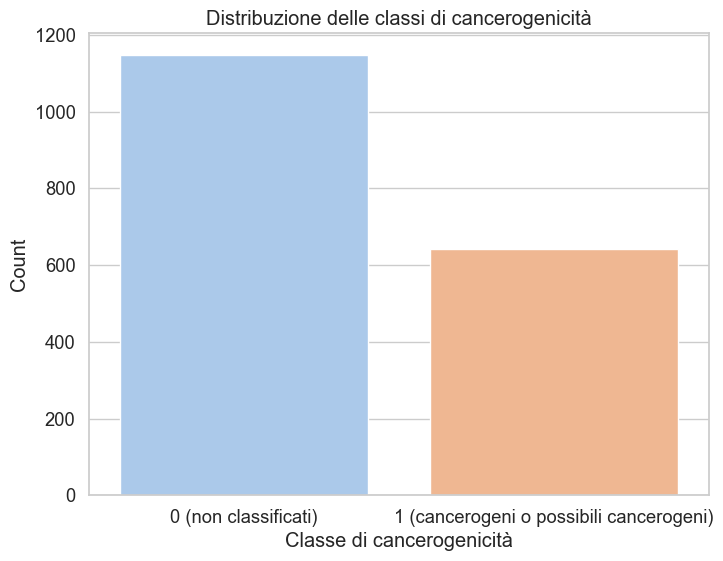

Numero di non classificati: 1147
Numero di cancerogeni / possibili cancerogeni: 643


In [522]:
# Plot della distribuzione usando seaborn
plt.figure(figsize=(8, 6))
sns.countplot(x='carcinogenicity_score', data=df_clean, palette='pastel')
plt.xticks([0, 1], ['0 (non classificati)', '1 (cancerogeni o possibili cancerogeni)'])
plt.xlabel('Classe di cancerogenicità')
plt.ylabel('Count')
plt.title('Distribuzione delle classi di cancerogenicità')
plt.show()

non_classificato = df_clean[df_clean["carcinogenicity_score"] == 0]
cancerogeno = df_clean[df_clean["carcinogenicity_score"] == 1]
print(f"Numero di non classificati: {len(non_classificato)}")
print(f"Numero di cancerogeni / possibili cancerogeni: {len(cancerogeno)}")

In [523]:
df_numeriche = df_clean.select_dtypes(include=['number'])
print(df_numeriche.columns)

Index(['moldb_average_mass', 'JCHEM_ACCEPTOR_COUNT',
       'JCHEM_AVERAGE_POLARIZABILITY', 'JCHEM_BIOAVAILABILITY',
       'JCHEM_DONOR_COUNT', 'JCHEM_FORMAL_CHARGE', 'JCHEM_GHOSE_FILTER',
       'JCHEM_LOGP', 'JCHEM_MDDR_LIKE_RULE', 'JCHEM_NUMBER_OF_RINGS',
       'JCHEM_PHYSIOLOGICAL_CHARGE', 'JCHEM_POLAR_SURFACE_AREA',
       'JCHEM_REFRACTIVITY', 'JCHEM_ROTATABLE_BOND_COUNT',
       'JCHEM_RULE_OF_FIVE', 'JCHEM_VEBER_RULE', 'carcinogenicity_score'],
      dtype='object')


**Correlazione tra ogni variabile numerica e la variabile target**

<Figure size 2000x2000 with 0 Axes>

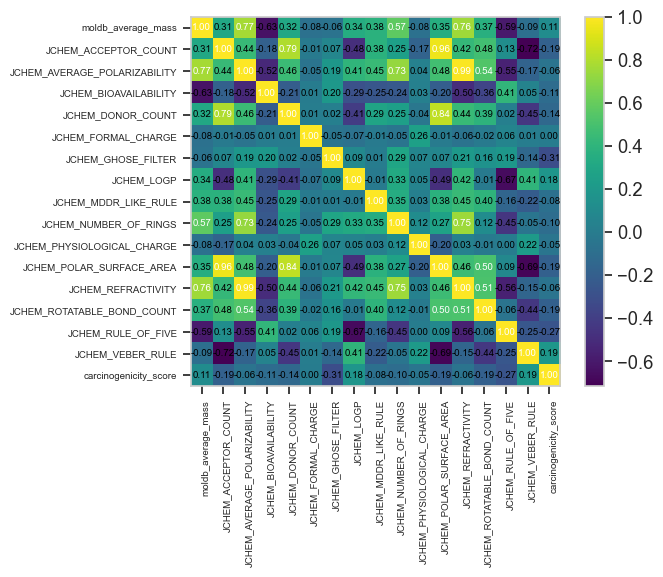

In [524]:
from mlxtend.plotting import scatterplotmatrix
colss = ['moldb_average_mass', 'JCHEM_ACCEPTOR_COUNT',
       'JCHEM_AVERAGE_POLARIZABILITY', 'JCHEM_BIOAVAILABILITY',
       'JCHEM_DONOR_COUNT', 'JCHEM_FORMAL_CHARGE', 'JCHEM_GHOSE_FILTER',
       'JCHEM_LOGP', 'JCHEM_MDDR_LIKE_RULE', 'JCHEM_NUMBER_OF_RINGS',
       'JCHEM_PHYSIOLOGICAL_CHARGE', 'JCHEM_POLAR_SURFACE_AREA',
       'JCHEM_REFRACTIVITY', 'JCHEM_ROTATABLE_BOND_COUNT',
       'JCHEM_RULE_OF_FIVE', 'JCHEM_VEBER_RULE', 'carcinogenicity_score']

from mlxtend.plotting import heatmap    
cm = np.corrcoef(df_clean[colss].values.T)   # Calcolo coefficiente di correlazione tra colonne  # Converto Dataframe in array Numpy   # Traspongo array
plt.figure(figsize=(20, 20))
hm = heatmap(cm,                          # Matrice di correlazione come input
             row_names=colss,              # Imposto le etichette per le righe
             column_names=colss,
            cell_font_size=7)           # Imposto le etichette per le colonne

plt.xticks(fontsize=7, rotation=90)
plt.yticks(fontsize=7, rotation=0)
plt.show()

In [525]:
df_clean.describe()

,moldb_average_mass,JCHEM_ACCEPTOR_COUNT,JCHEM_AVERAGE_POLARIZABILITY,JCHEM_BIOAVAILABILITY,JCHEM_DONOR_COUNT,JCHEM_FORMAL_CHARGE,JCHEM_GHOSE_FILTER,JCHEM_LOGP,JCHEM_MDDR_LIKE_RULE,JCHEM_NUMBER_OF_RINGS,JCHEM_PHYSIOLOGICAL_CHARGE,JCHEM_POLAR_SURFACE_AREA,JCHEM_REFRACTIVITY,JCHEM_ROTATABLE_BOND_COUNT,JCHEM_RULE_OF_FIVE,JCHEM_VEBER_RULE,carcinogenicity_score
count,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000,1790.000000
mean,297.962796,1.615084,23.508142,0.916760,0.543575,0.034637,0.339665,3.095456,0.040782,1.644693,-0.030726,33.713061,59.623390,2.037989,0.651397,0.660894,0.359218
std,171.065752,2.543066,16.139935,0.276322,1.399932,0.614640,0.473728,3.170604,0.197840,1.650588,0.680031,50.771995,42.072629,3.622134,0.476661,0.473538,0.479905
min,9.011100,0.000000,0.435901,0.000000,0.000000,-12.000000,0.000000,-14.529231,0.000000,0.000000,-5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,193.242300,0.000000,10.749738,1.000000,0.000000,0.000000,0.000000,0.580984,0.000000,0.000000,0.000000,0.000000,26.205600,0.000000,0.000000,0.000000,0.000000
50%,283.230350,0.000000,24.645218,1.000000,0.000000,0.000000,0.000000,3.010901,0.000000,2.000000,0.000000,17.070000,65.581200,1.000000,1.000000,1.000000,0.000000
75%,360.878000,3.000000,31.397646,1.000000,1.000000,0.000000,1.000000,5.567426,0.000000,3.000000,0.000000,52.600000,80.055600,3.000000,1.000000,1.000000,1.000000
max,1961.036000,28.000000,156.669938,1.000000,20.000000,10.000000,1.000000,18.436200,1.000000,18.000000,6.000000,627.070000,397.851700,48.000000,1.000000,1.000000,1.000000


In [526]:
print(dir(pn))

['Story', '__all__', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__path__', '__spec__', 'story']


In [527]:
# Calcoli riassuntivi
mean_mass = df_clean["moldb_average_mass"].mean()
mean_logp = df_clean["JCHEM_LOGP"].mean()
mean_refractivity = df_clean["JCHEM_REFRACTIVITY"].mean()
perc_exogenous = df_clean[df_clean["origin"] == "Exogenous"].shape[0] / df_clean.shape[0] * 100
perc_carc = df_clean[df_clean["carcinogenicity_score"] == 1].shape[0] / df_clean.shape[0] * 100

# Narrazione testuale
story_text = f"""
L'analisi del dataset ha rivelato alcune caratteristiche chiave delle molecole in relazione alla loro potenziale cancerogenicità.

📊 Complessivamente, il valore medio della massa molecolare è di circa {mean_mass:.1f} g/mol, indicando la presenza di molecole di dimensioni medio-alte nel dataset. Il valore medio di LogP è pari a {mean_logp:.2f}, suggerendo un grado di lipofilia moderato: molte molecole hanno quindi la potenzialità di attraversare facilmente le membrane cellulari. La rifrazione molare media, un indice della polarizzabilità elettronica, è {mean_refractivity:.2f}, coerente con la presenza di molecole complesse.

🧪 Dal punto di vista tossicologico, il dataset mostra che circa il {perc_carc:.1f}% delle molecole sono classificate come cancerogene o potenzialmente tali. Inoltre, il {perc_exogenous:.1f}% delle molecole ha origine esogena, sottolineando come molte di esse possano derivare da sostanze industriali, contaminanti ambientali o farmaci.

📈 Un'osservazione interessante riguarda le relazioni tra le variabili: molecole con massa molecolare elevata tendono ad avere anche valori alti di rifrazione, il che è chimicamente plausibile poiché una maggiore massa comporta una struttura più complessa e quindi più facilmente polarizzabile.

🧬 Le molecole cancerogene tendono a concentrarsi nella zona del grafico che mostra alti valori sia di massa che di rifrazione molare. Questo suggerisce che molecole più pesanti e polarizzabili possano avere una maggiore capacità di interazione con bersagli biologici, come DNA o proteine cellulari, aumentando il rischio di effetti mutageni.

💡 Tuttavia, è importante sottolineare che nessuna singola variabile è risultata fortemente predittiva della cancerogenicità. Piuttosto, il rischio sembra emergere da un insieme di caratteristiche strutturali, confermando la necessità di un approccio multivariato per una valutazione più accurata.

L'esplorazione dei dati, dunque, mostra che la cancerogenicità non dipende da un solo fattore, ma è il risultato di **interazioni sinergiche tra massa, polarità, stato fisico, lipofilia e origine molecolare**.
"""

# Storia
story = pn.Story(story_text)
print(story_text)


L'analisi del dataset ha rivelato alcune caratteristiche chiave delle molecole in relazione alla loro potenziale cancerogenicità.

📊 Complessivamente, il valore medio della massa molecolare è di circa 298.0 g/mol, indicando la presenza di molecole di dimensioni medio-alte nel dataset. Il valore medio di LogP è pari a 3.10, suggerendo un grado di lipofilia moderato: molte molecole hanno quindi la potenzialità di attraversare facilmente le membrane cellulari. La rifrazione molare media, un indice della polarizzabilità elettronica, è 59.62, coerente con la presenza di molecole complesse.

🧪 Dal punto di vista tossicologico, il dataset mostra che circa il 35.9% delle molecole sono classificate come cancerogene o potenzialmente tali. Inoltre, il 95.9% delle molecole ha origine esogena, sottolineando come molte di esse possano derivare da sostanze industriali, contaminanti ambientali o farmaci.

📈 Un'osservazione interessante riguarda le relazioni tra le variabili: molecole con massa moleco

In [528]:
storia = pn.Story(df_clean, font="Verdana")

In [529]:
grafico = (storia
           .mark_bar()
           .encode(
               x='JCHEM_LOGP:Q',
               y='JCHEM_REFRACTIVITY:Q',
               color=alt.Color('moldb_average_mass',
                               scale=alt.Scale(scheme='viridis'))
           )
           .properties(
               title='Relazione tra massa molecolare, rifrazione e lipofilia',
               width=700,
               height=400
           )
          )
grafico


C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users

In [530]:
# Accorpo le categorie più frequenti per visualizzarle meglio nella legenda successiva
top_labels = df_clean['locations_all'].value_counts().nlargest(25).index
df_clean['loc_simplified'] = df_clean['locations_all'].apply(
    lambda x: x if x in top_labels else 'Altri'
)


# Grafico base
base = alt.Chart(df_clean).mark_point().encode(
    x='JCHEM_LOGP',
    y='JCHEM_REFRACTIVITY',
    color=alt.Color('loc_simplified:N',
    legend=alt.Legend(title='Localizzazione della molecola'),
    scale=alt.Scale(scheme='category10')
),
tooltip=['common_name', 'moldb_average_mass', 'JCHEM_LOGP', 'JCHEM_REFRACTIVITY', 'loc_simplified']
).properties(
    width=700,
    height=400,
    title='Relazione tra numero di anelli ciclici, rifrazione e lipofilia'
)

# Linea verticale
line = alt.Chart(pd.DataFrame({'x': [3.09]})).mark_rule(
    color='red',
    strokeDash=[5, 5],
    strokeWidth=2
).encode(x='x:Q')

# Compongo grafico
final_chart = base + line
final_chart

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users\Maura\anaconda\Lib\site-packages\altair\utils\core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

C:\Users

alt.LayerChart(...)

# 🔬 **Cosa ci racconta questo grafico?**

In questo scatter plot vediamo tracciata una relazione tra due proprietà chimico-fisiche fondamentali delle molecole:

* **Asse X – LogP**: la lipofilia, ovvero quanto una molecola è solubile nei grassi rispetto all'acqua.
* **Asse Y – Rifrazione molare**: un indicatore della **polarizzabilità** elettronica e quindi della complessità strutturale.

Ogni punto rappresenta una molecola, colorata in base alla sua **localizzazione cellulare prevalente** (semplificata in categorie testuali), mentre una **linea tratteggiata rossa verticale** evidenziamediolore soglia di LogP (≈3.09), potenzialmente significativo nella distribuzione delle molecole f
---

### 🧬 **Pattern interessant1. **Molecole più idrofobe (a destra della linea rossa)** tendono a concentrarsi in zone con rifrazione intermedia-alta, suggerendo che molecole più complesse (e quindi più rifrangenti) sono anche più lipofile. Questo ha implicazioni tossicologiche: molecole lipofile attraversano facilmente le membrane biologiche e possono **accumularsi nei tessuti**.

2. **La maggior parte delle molecole è concentrata nell’area inferiore centrale**, suggerendo che la chimica della vita (e dei composti analizzati) ruota intorno a molecole con **moderata polarizzabilità e lipofilia**.

3. **Distribuzione delle localizzazioni molecolari**:

   * Le **molecole localizzate nella membrana (viola chiaro) e nel citoplasma** (rosso) sono le più diffuse e presenti in un’ampia gamma di LogP e rifrazione.
   * Le molecole presenti nel *citoplasma* (arancione) sono presenti in modesta misura in questo dataset, mentre quelle presenti nei *mitocondri* sono più rare.
   * Le molecole classificate come **"Altri"** si concentrano in un’area ristretta ma densa a **bassa rifrazione e logP vicino allo zero**.
   * Alcune **localizzazioni rare**, come **giunzioni cellulari** o **membrane specializzate**, si collocano ai margini dello spazio chimico, rappresentando **outlier** potenzialmente interessanti.enmnteressanti.

---

### 🧠 **Interpretazione biologico-tossicologica**

🔹 Molecole lipofile e altamente rifrangenti potrebbero avere un **rischio maggiore di cancerogenicità**, poiché:

* penetrano più facilmente nelle cellule,
* possono legarsi in modo aspecifico a proteine o DNA,
* resistono ai processi di degradazione.

🔹 D'altra parte, la loro localizzazione può suggerire una **funzionalità biologica cruciale** (es. localizzazione nelle membrane, nel citoplasma, nei compartimenti extracellarkdown da inserire direttamente in Streamlit! Vuoi?


In [531]:
# Seleziono le colonne numeriche, escludendo target
df_numeriche = df_clean.select_dtypes(include=[np.number]).drop(columns='carcinogenicity_score')

# Calcolo la correlazione con il target
corr = df_clean[df_numeriche.columns].corrwith(df_clean['carcinogenicity_score'])

print(corr)

# Variabili con correlazione significativa (es. > 0.1)
selezionate = corr[abs(corr) > 0.1].index.tolist()
print("Variabili utili:", selezionate)

moldb_average_mass              0.114990
JCHEM_ACCEPTOR_COUNT           -0.185265
JCHEM_AVERAGE_POLARIZABILITY   -0.058625
JCHEM_BIOAVAILABILITY          -0.107389
JCHEM_DONOR_COUNT              -0.136881
JCHEM_FORMAL_CHARGE             0.001381
JCHEM_GHOSE_FILTER             -0.308332
JCHEM_LOGP                      0.180770
JCHEM_MDDR_LIKE_RULE           -0.083735
JCHEM_NUMBER_OF_RINGS          -0.103406
JCHEM_PHYSIOLOGICAL_CHARGE     -0.048374
JCHEM_POLAR_SURFACE_AREA       -0.189558
JCHEM_REFRACTIVITY             -0.058404
JCHEM_ROTATABLE_BOND_COUNT     -0.189539
JCHEM_RULE_OF_FIVE             -0.273308
JCHEM_VEBER_RULE                0.191967
dtype: float64
Variabili utili: ['moldb_average_mass', 'JCHEM_ACCEPTOR_COUNT', 'JCHEM_BIOAVAILABILITY', 'JCHEM_DONOR_COUNT', 'JCHEM_GHOSE_FILTER', 'JCHEM_LOGP', 'JCHEM_NUMBER_OF_RINGS', 'JCHEM_POLAR_SURFACE_AREA', 'JCHEM_ROTATABLE_BOND_COUNT', 'JCHEM_RULE_OF_FIVE', 'JCHEM_VEBER_RULE']


In [532]:
fig = px.scatter(df_clean, x='moldb_average_mass', y='carcinogenicity_score',
                 color='origin',  
                 size='JCHEM_ACCEPTOR_COUNT',  
                 hover_data=['JCHEM_LOGP', 'JCHEM_DONOR_COUNT'],
                 title='Relazione tra peso molecolare e carcinogenicità')
fig.show()


top_corr = corr[abs(corr) > 0.1]

# Converto in DataFrame
df_top_corr = top_corr.reset_index()

# Rinomino le due colonne
df_top_corr = df_top_corr.iloc[:, :2]
df_top_corr.columns = ['Variabile', 'Correlazione']

# Barplot con Plotly
fig = px.bar(df_top_corr, x='Variabile', y='Correlazione',
             title='Correlazione con carcinogenicity_score',
             labels={'Variabile': 'Variabile', 'Correlazione': 'Correlazione'})
fig.update_layout(xaxis_tickangle=45)
fig.show()


fig = px.scatter(df_clean, x='moldb_average_mass', y='carcinogenicity_score',
                 color='state', 
                 size='JCHEM_POLAR_SURFACE_AREA', 
                 hover_data=['JCHEM_LOGP', 'JCHEM_POLAR_SURFACE_AREA'],
                 title='Relazione tra peso molecolare e carcinogenicità')
fig.show()



In [533]:
# Impostazioni grafiche
sns.set(style="whitegrid", palette="muted", font_scale=1.2)

# Variabili molecolari da analizzare
vars_molecolari = ['moldb_average_mass', 'JCHEM_LOGP', 'state', 'origin']



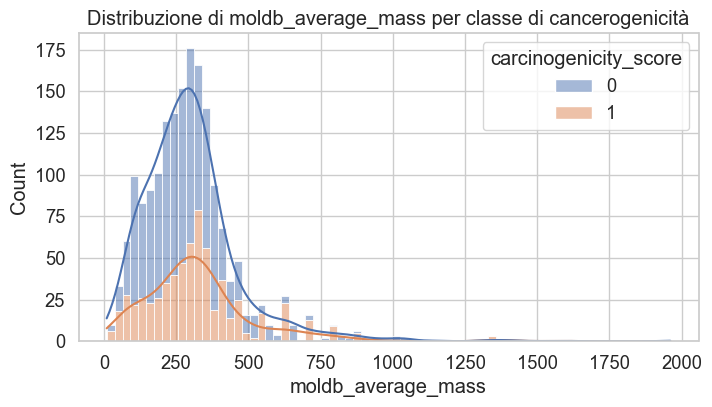

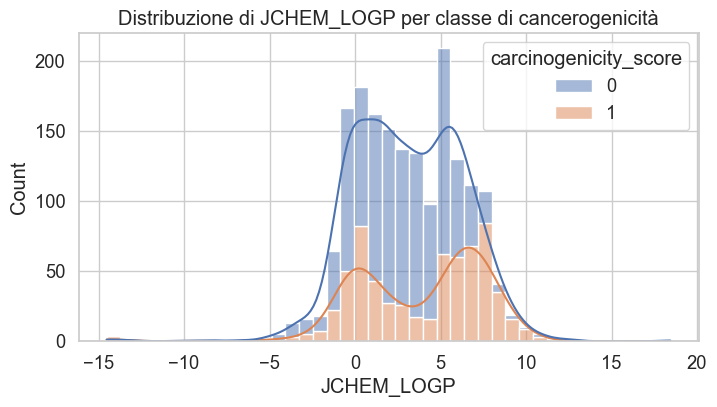

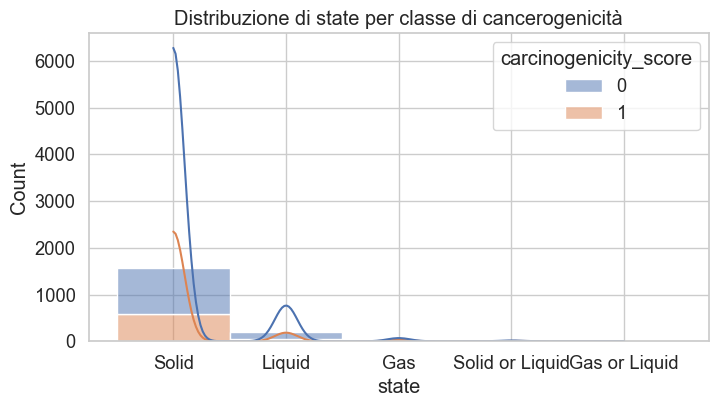

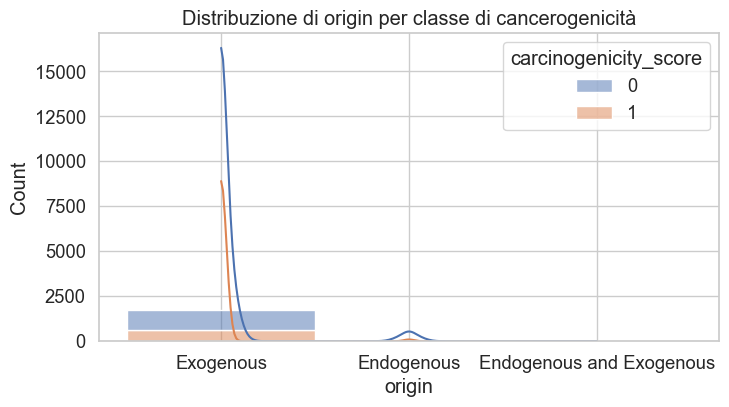

C:\Users\Maura\AppData\Local\Temp\ipykernel_1760\458371011.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




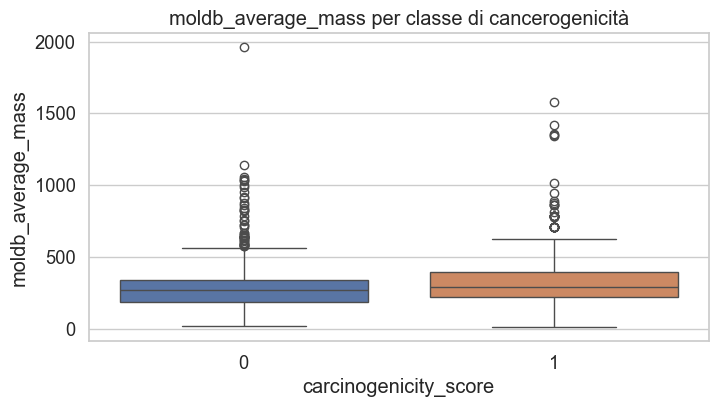

C:\Users\Maura\AppData\Local\Temp\ipykernel_1760\458371011.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




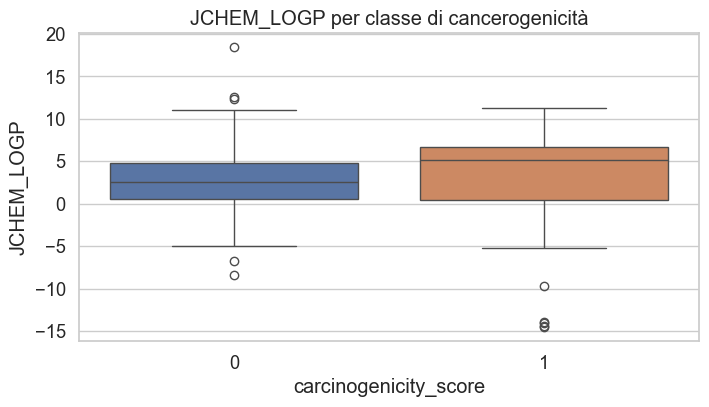

C:\Users\Maura\AppData\Local\Temp\ipykernel_1760\458371011.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




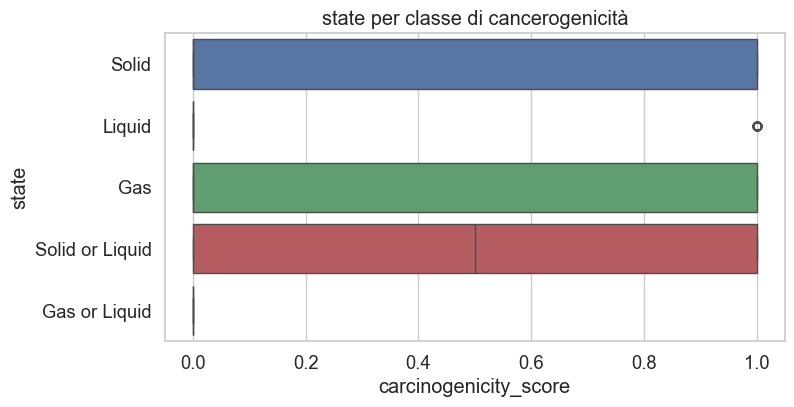

C:\Users\Maura\AppData\Local\Temp\ipykernel_1760\458371011.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




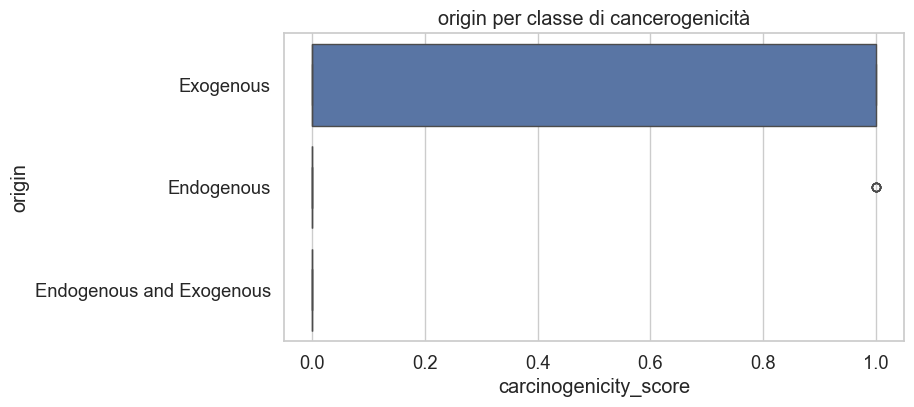

In [534]:
# 1️⃣ Istogrammi / Density plot per ogni variabile molecolare
for col in vars_molecolari:
    plt.figure(figsize=(8,4))
    sns.histplot(data=df_clean, x=col, kde=True, hue='carcinogenicity_score', multiple="stack", palette='deep')
    plt.title(f'Distribuzione di {col} per classe di cancerogenicità')
    plt.show()

# ----------------------------------------------
# 2️⃣ Boxplot
for col in vars_molecolari:
    plt.figure(figsize=(8,4))
    sns.boxplot(data=df_clean, x='carcinogenicity_score', y=col, palette='deep')
    plt.title(f'{col} per classe di cancerogenicità')
    plt.show()



In [535]:
fig_box = px.scatter(df_clean, x='moldb_average_mass', y='JCHEM_REFRACTIVITY',
                 color='carcinogenicity_score',
                 hover_name='common_name',
                 hover_data=['state', 'origin', 'JCHEM_LOGP'])
plt.show()

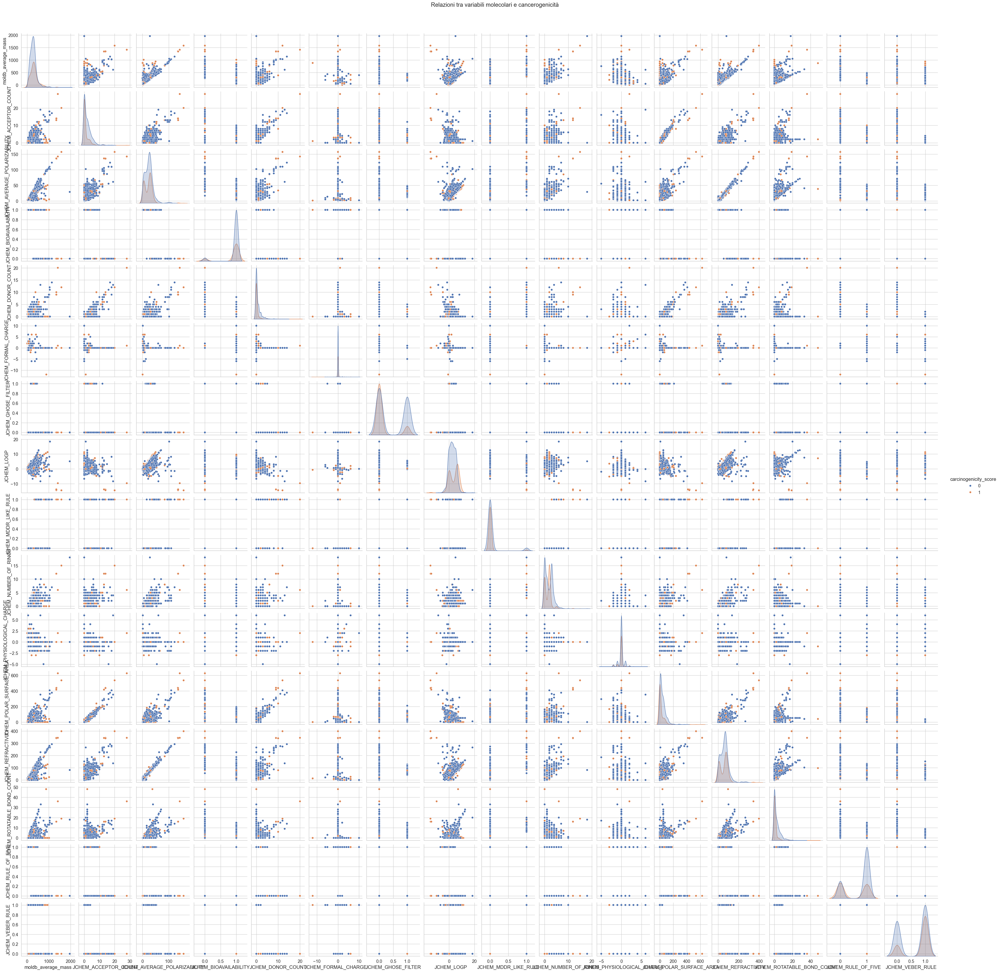

In [536]:
# Pairplot per esplorare relazioni tra tutte le variabili molecolari
sns.pairplot(df_clean, vars=df_numeriche, hue='carcinogenicity_score', palette='deep')
plt.suptitle('Relazioni tra variabili molecolari e cancerogenicità', y=1.02)
plt.show()

✅ **Considerazioni e conclusioni finali**
 
L’analisi esplorativa condotta su questo dataset ci ha permesso di guardare dentro la chimica delle molecole con una lente statistica. E ciò che emerge è chiaro: **non esiste un singolo "colpevole" della cancerogenicità**, ma piuttosto una rete di fattori intrecciati che insieme concorrono a determinarla.

 Iniziamo da un dato cruciale: il dataset è **sbilanciato**, con circa **il doppio delle molecole non cancerogene** rispetto a quelle cancerogene o potenzialmente tali. Questo riflette la realtà biologica ma impone attenzione nell’interpretazione dei dati.

 La **matrice di correlazione** conferma che **nessuna variabile numerica** – da sola – spiega il fenomeno cancerogeno. Le correlazioni più alte, seppur deboli, sono positive: molecole con **massa molecolare maggiore**, **superficie polare più estesa** e **rifrazione molare più elevata** tendono ad avere un punteggio cancerogeno più alto. Questo ci suggerisce che molecole **più grandi, più polari e strutturalmente complesse** potrebbero avere maggiori probabilità di interagire con strutture biologiche sensibili, come il DNA.

 Dal punto di vista chimico-fisico, queste variabili sono intercorrelate: **più una molecola è grande**, **più tende ad avere legami multipli**, **più è polarizzabile**, e **più aumenta la sua rifrazione molare**. Inoltre, **molecole pesanti** tendono ad avere **più anelli aromatici o eterociclici**, strutture spesso associate a potenziale mutageno. In sintesi, la **complessità strutturale** può tradursi in **maggiore reattività biologica**.

 Anche la **provenienza della molecola** conta: le **sostanze esogene**, spesso derivate da sintesi industriale o inquinanti ambientali, mostrano una maggiore incidenza di classificazione cancerogena. Non è un caso: molte di queste molecole sono **xenobiotici**, cioè sostanze estranee all'organismo, che spesso **sfuggono ai meccanismi di detossificazione** o **generano metaboliti reattivi**.

 E per quanto riguarda lo **stato fisico**? Da solo non basta a spiegare la cancerogenicità, ma in **combinazione con la massa molecolare** può diventare rilevante. Le **molecole solide e pesanti** sembrano avere un rischio maggiore. Questo potrebbe essere legato alla loro **persistenza nell'ambiente**, alla **difficoltà di degradazione** e alla tendenza ad **accumularsi nei tessuti biologici**.

 Le **forti correlazioni tra variabili strutturali**, come massa, rifrazione, polarizzabilità e numero di anelli, ci raccontano un’altra verità: **la tossicità è multiforme**. Non può essere spiegata linearmente. Serve un approccio **multivariato, integrato, sistemico**.

 Questa analisi dunque suggerisce che:

* La **cancerogenicità molecolare** è il risultato di **interazioni sinergiche** tra molteplici caratteristiche: **dimensione**, **polarità**, **forma**, **origine**, **persistenza** in alcuni casi correlate proporzionalmente tra di loro.
* Non esiste un unico predittore “magico”, ma **un profilo molecolare complesso** da interpretare nel suo insieme.
* Questo riflette ciò che già la tossicologia molecolare ci insegna: la pericolosità di una sostanza **nasce dalla sua struttura**, **dalle sue proprietà fisico-chimiche**, e **dalla sua capacità di interagire selettivamente con bersagli biologici**.

Da qui, il passo successivo è naturale: per valutare in modo affidabile il rischio cancerogeno serve un approccio **modellistico e predittivo**, basato su **dati multidimensionali** e metodi avanzati.

L’esplorazione dei dati condotta in questo lavoro è solo il punto di partenza. Ma è già un passo fondamentale verso uno **studio della cancerogenicità e delle sostanze nocive più trasparente, interpretabile e guidata dai dati**.
